In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch import optim
from PIL import Image
from torchvision import transforms as T
from torchvision import models
from matplotlib import pyplot as plt

In [2]:
img_size = 512
device = torch.device('cuda')
img_transforms = T.Compose([
    T.Resize((img_size, img_size)),
    T.ToTensor()
])

In [3]:
def load_img(img_fn):
    global device
    global img_transforms
    image = Image.open(img_fn)
    image = img_transforms(image)
    # to batch
    image = image.unsqueeze(0).to(device, torch.float)
    return image

def to_image(img_tensor):
    image = img_tensor.cpu().clone()
    image = image.squeeze(0)
    image = T.ToPILImage()(image)
    return image

def plot_img(img_tensor, title=None):
    image = to_image(img_tensor) if isinstance(content_img, torch.Tensor) else img_tensor
    plt.imshow(image)
    if title is not None:
        plt.title(title)

def plot_imgs(imgs, cols=3, size=7, title=""):
    rows = len(imgs)//cols + 1
    fig = plt.figure(figsize=(cols*size, rows*size))
    for i, img in enumerate(imgs):
        image = to_image(img) if isinstance(img, torch.Tensor) else img
        fig.add_subplot(rows, cols, i+1)
        plt.imshow(image)
    plt.suptitle(title)
    plt.show()

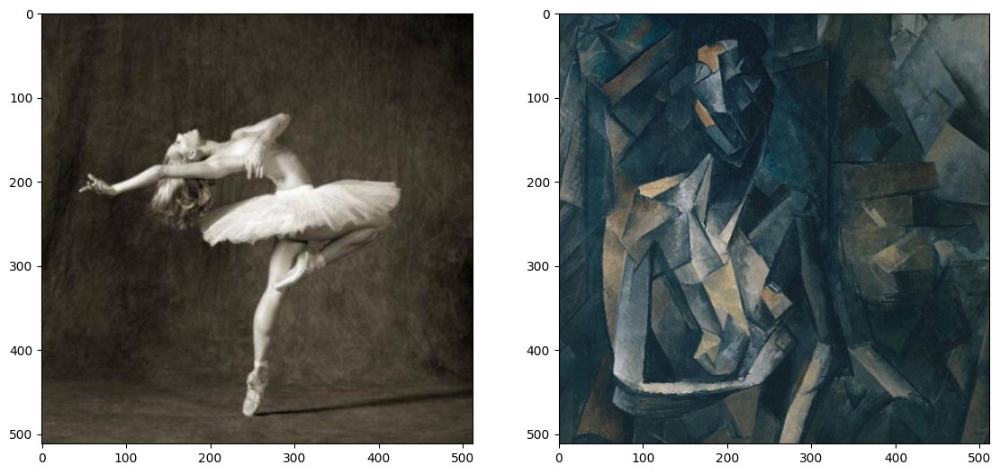

In [4]:
content_img = load_img('/kaggle/input/content-img/content_dancing.jpg')
style_img = load_img('/kaggle/input/style-img/style_seated-nude.jpg')
plot_imgs([content_img, style_img])

In [5]:
def compute_gram_matrix(feature_map):
    batchsize, c, w, h = feature_map.size()
    feature = feature_map.view(batchsize*c, w*h)
    gram_matrix = torch.mm(feature, feature.T)
    gram_matrix = gram_matrix/(batchsize*c*w*h) #normalize
    return gram_matrix

# ContentLoss (perceptual loss) is MSE between input_feature and target feature
class ContentLoss(nn.Module):
    def __init__(self, target_feature):
        super(ContentLoss, self).__init__()
        # target_feature is an constant, not variable
        self.target_feature = target_feature.detach()

    def forward(self, input_feature):
        self.loss = F.mse_loss(input_feature, self.target_feature)
        return input_feature

# styleLoss is MSE between gram_matrix of input_feature and target feature
class StyleLoss(nn.Module):
    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        gram_matrix = compute_gram_matrix(target_feature)
        self.target_gram_matrix = gram_matrix.detach()

    def forward(self, input_feature):
        input_gram_matrix = compute_gram_matrix(input_feature)
        self.loss = F.mse_loss(input_gram_matrix, self.target_gram_matrix)
        return input_feature

# Additionally, VGG networks are trained on images with
# each channel normalized by mean=[0.485, 0.456, 0.406] and std=[0.229, 0.224, 0.225].
# We will use them to normalize the image before sending it into the network.
class Normalization(nn.Module):
    def __init__(self):
        super(Normalization, self).__init__()
        self.mean = torch.tensor([0.485, 0.456, 0.406]).view(-1, 1, 1).to(device)
        self.std = torch.tensor([0.229, 0.224, 0.225]).view(-1, 1, 1).to(device)

    def forward(self, image_tensor):
        return (image_tensor - self.mean) / self.std

In [6]:
def build_ST_model(
    cnn_model, normalization,
    content_layer_names, style_layer_names,
    content_img, style_img):
    """Build a style_transfer model with specify style and content"""

    cnn_model.eval()
    ST_model = nn.Sequential(normalization)
    all_content_loss = []
    all_style_loss = []
    i = 0

    for layer in cnn_model.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)

        ST_model.add_module(name=name, module=layer)

        if name in content_layer_names:
            target_feature = ST_model(content_img)
            c_loss = ContentLoss(target_feature=target_feature)
            ST_model.add_module(f'content_loss_{i}', module=c_loss)
            all_content_loss.append(c_loss)

        if name in style_layer_names:
            target_feature = ST_model(style_img)
            s_loss = StyleLoss(target_feature=target_feature)
            ST_model.add_module(f'style_loss_{i}', module=s_loss)
            all_style_loss.append(s_loss)

    return ST_model, all_content_loss, all_style_loss

In [7]:
# load pretrain-model
cnn_model = models.vgg19(pretrained=True).features.to(device).eval()
normalization = Normalization()
content_layers = ['conv_4']
style_layers = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:07<00:00, 78.3MB/s] 


In [8]:
def run_style_transfer(
    cnn_model, normalization, content_layers,
    style_layers, content_img, style_img, num_steps,
    style_weight, content_weight):

    ST_model, content_losses, style_losses = build_ST_model(
        cnn_model, normalization,
        content_layers, style_layers,
        content_img, style_img)

    input_image = content_img.clone().requires_grad_()
    optimizer = optim.LBFGS([input_image])

    run = [0]

    def closure():
        input_image.data.clamp_(0, 1)
        optimizer.zero_grad()
        content_score, style_score = 0, 0
        ST_model(input_image)

        for c_loss in content_losses:
            content_score += c_loss.loss

        for s_loss in style_losses:
            style_score += s_loss.loss
        
        run[0] += 1
        if run[0] % 50 == 0: 
            print("content_loss: ", content_score.item(), "style_loss: ", style_score.item())

        total_loss = content_score * content_weight + style_score * style_weight
        total_loss.backward()

        return total_loss

    print('Optimizing...')
    while run[0] <= num_steps:
        optimizer.step(closure)

    input_image.data.clamp_(0, 1)
    return input_image

In [9]:
def output(content_path, style_path, num_steps, style_weight, content_weight):
  content_img = load_img(content_path)
  style_img = load_img(style_path)

  ST_model, all_content_loss, all_style_loss = build_ST_model(
      cnn_model, normalization, content_layers, style_layers, content_img, style_img)

  output_img = run_style_transfer(
      cnn_model, normalization, content_layers,
      style_layers, content_img, style_img, num_steps=num_steps,
      style_weight = style_weight , content_weight = content_weight)
  
  return output_img

In [10]:
content_path = '/kaggle/input/content-img/content_dancing.jpg'
style_path = '/kaggle/input/style-img/style_seated-nude.jpg'
output_image = output(content_path, style_path, 3000, 1000000, 1)

Optimizing...
content_loss:  4.128080368041992 style_loss:  4.092991730431095e-06
content_loss:  3.014976978302002 style_loss:  1.1180247838638024e-06
content_loss:  2.642815589904785 style_loss:  7.013054528215434e-07
content_loss:  2.4866816997528076 style_loss:  4.729510862944153e-07
content_loss:  2.400623321533203 style_loss:  3.393915051219665e-07
content_loss:  2.345813751220703 style_loss:  2.6153759336011717e-07
content_loss:  2.31295108795166 style_loss:  2.0967360114809708e-07
content_loss:  2.2866954803466797 style_loss:  1.8043429861336335e-07
content_loss:  2.266489028930664 style_loss:  1.6410024272772716e-07
content_loss:  2.2517805099487305 style_loss:  1.5479801618312194e-07
content_loss:  2.2393798828125 style_loss:  1.4902460065968626e-07
content_loss:  2.2308692932128906 style_loss:  1.450377027367722e-07
content_loss:  2.2240562438964844 style_loss:  1.4230759859401587e-07
content_loss:  2.218613624572754 style_loss:  1.4017074079220038e-07
content_loss:  2.213796

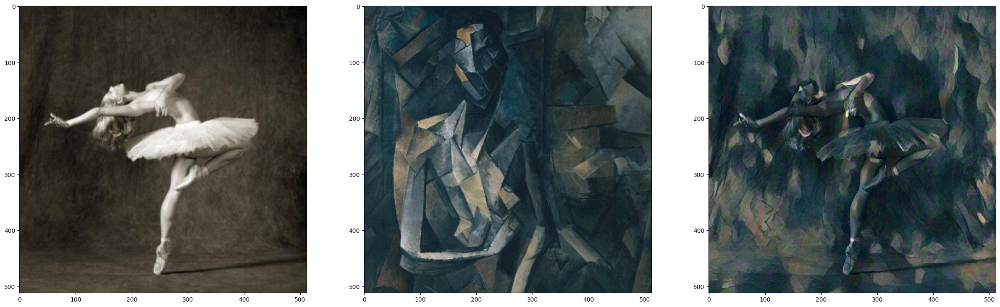

In [11]:
plot_imgs([load_img(content_path), load_img(style_path), output_image], size=10)

Optimizing...
content_loss:  20.833499908447266 style_loss:  3.762682172236964e-05
content_loss:  18.965185165405273 style_loss:  1.5841329513932578e-05
content_loss:  17.069377899169922 style_loss:  8.190691914933268e-06
content_loss:  15.449129104614258 style_loss:  4.370960596133955e-06
content_loss:  14.334269523620605 style_loss:  2.4272844711958896e-06
content_loss:  13.5232515335083 style_loss:  1.4380950688064331e-06
content_loss:  12.941411972045898 style_loss:  9.668456186773255e-07
content_loss:  12.531631469726562 style_loss:  7.401500852211029e-07
content_loss:  12.238016128540039 style_loss:  6.054204959582421e-07
content_loss:  12.009758949279785 style_loss:  5.401774387792102e-07
content_loss:  11.846870422363281 style_loss:  4.900333010482427e-07
content_loss:  11.714557647705078 style_loss:  4.5131852743907075e-07
content_loss:  11.624027252197266 style_loss:  4.126463011289161e-07
content_loss:  11.534917831420898 style_loss:  3.851462224702118e-07
content_loss:  11.

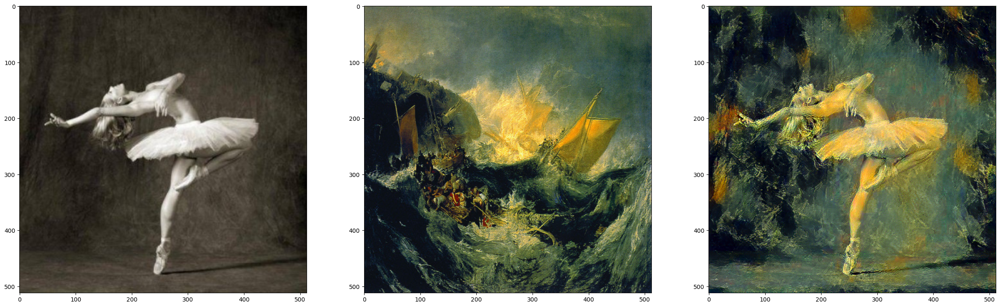

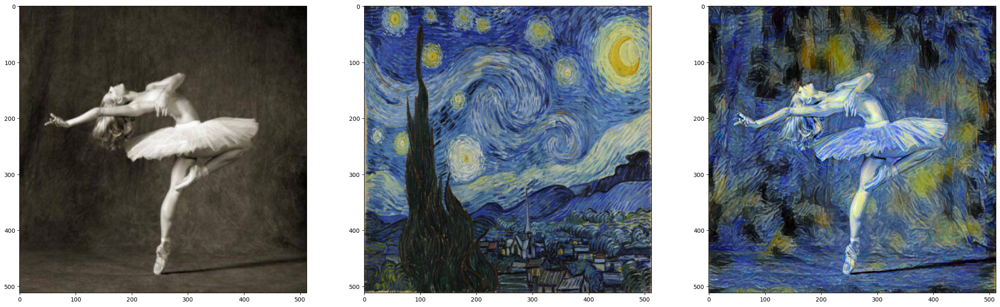

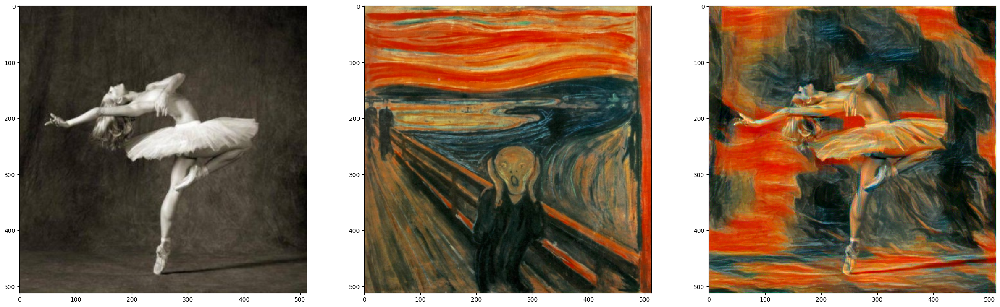

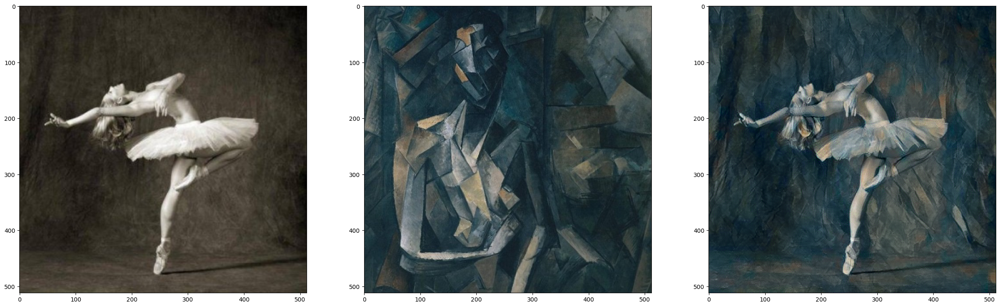

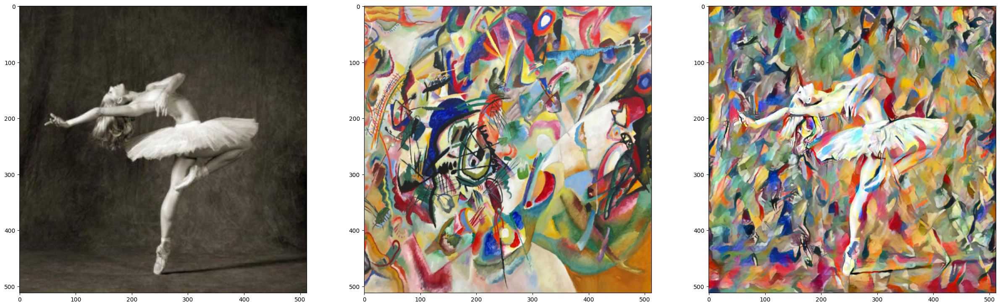

In [12]:
content_path = '/kaggle/input/content-img/content_dancing.jpg'
style_path1 = '/kaggle/input/style-img/style_the-shipwreck-of-the-minotaur.jpg'
style_path2 = '/kaggle/input/style-img/style_the-starry-night.jpg'
style_path3 = '/kaggle/input/style-img/style_the-scream.jpg'
style_path4 = '/kaggle/input/style-img/style_seated-nude.jpg'
style_path5 = '/kaggle/input/style-img/style_composition-vii.jpg'
output_image1 = output(content_path, style_path1, 1000, 1000000, 1) 
output_image2 = output(content_path, style_path2, 1000, 1000000, 1) 
output_image3 = output(content_path, style_path3, 1000, 1000000, 1) 
output_image4 = output(content_path, style_path4, 1000, 1000000, 1) 
output_image5 = output(content_path, style_path5, 1000, 1000000, 1) 
plot_imgs([load_img(content_path), load_img(style_path1), output_image1], size=10)
plot_imgs([load_img(content_path), load_img(style_path2), output_image2], size=10)
plot_imgs([load_img(content_path), load_img(style_path3), output_image3], size=10)
plot_imgs([load_img(content_path), load_img(style_path4), output_image4], size=10)
plot_imgs([load_img(content_path), load_img(style_path5), output_image5], size=10)

# **Style Weight & Content Weight**

In [13]:
def run_style_transfer_update(
    cnn_model, normalization, content_layers,
    style_layers, content_img, style_img, num_steps,
    style_weight, content_weight):

    ST_model, content_losses, style_losses = build_ST_model(
        cnn_model, normalization,
        content_layers, style_layers,
        content_img, style_img)

    input_image = content_img.clone().requires_grad_()
    optimizer = optim.LBFGS([input_image])

    run = [0]
    content_losses_history = []
    style_losses_history = []
    total_losses_history = []


    def closure():
        input_image.data.clamp_(0, 1)
        optimizer.zero_grad()
        content_score, style_score = 0, 0
        ST_model(input_image)

        for c_loss in content_losses:
            content_score += c_loss.loss

        for s_loss in style_losses:
            style_score += s_loss.loss
        
        run[0] += 1
        if run[0] % 50 == 0: 
            print("content_loss: ", content_score.item(), "style_loss: ", style_score.item())

        total_loss = content_score * content_weight + style_score * style_weight
        total_loss.backward()
        content_losses_history.append(content_score.item())
        style_losses_history.append(style_score.item())
        total_losses_history.append(total_loss.item())

        return total_loss

    print('Optimizing...')
    while run[0] <= num_steps:
        optimizer.step(closure)

    input_image.data.clamp_(0, 1)
    return input_image, content_losses_history, style_losses_history, total_losses_history

In [14]:
def output_update(content_path, style_path, num_steps, style_weight, content_weight):
  content_img = load_img(content_path)
  style_img = load_img(style_path)

  ST_model, all_content_loss, all_style_loss = build_ST_model(
      cnn_model, normalization, content_layers, style_layers, content_img, style_img)

  output_img, content_loss, style_loss, total_loss = run_style_transfer_update(
      cnn_model, normalization, content_layers,
      style_layers, content_img, style_img, num_steps=num_steps,
      style_weight = style_weight , content_weight = content_weight)
  
  return output_img, content_loss, style_loss, total_loss

**Change Style Weight**

style_weight = [1000,10000,100000,1000000,10000000], 
content_weight = 1, 
num_steps = 1000, 
content = dancing image, style = seated nude image

In [15]:
content_path = '/kaggle/input/content-img/content_dancing.jpg'
style_path = '/kaggle/input/style-img/style_seated-nude.jpg'

output_image1, content_loss1, style_loss1, total_loss1 = output_update(content_path, style_path, 1000, 1000, 1)
output_image2, content_loss2, style_loss2, total_loss2 = output_update(content_path, style_path, 1000, 10000, 1)
output_image3, content_loss3, style_loss3, total_loss3 = output_update(content_path, style_path, 1000, 100000, 1)
output_image4, content_loss4, style_loss4, total_loss4 = output_update(content_path, style_path, 1000, 1000000, 1)
output_image5, content_loss5, style_loss5, total_loss5 = output_update(content_path, style_path, 1000, 10000000, 1)

Optimizing...
content_loss:  0.18253248929977417 style_loss:  0.0004624444991350174
content_loss:  0.20679956674575806 style_loss:  0.0004145221319049597
content_loss:  0.2366287112236023 style_loss:  0.00037247693398967385
content_loss:  0.25358012318611145 style_loss:  0.00033799782977439463
content_loss:  0.247251957654953 style_loss:  0.00033522897865623236
content_loss:  0.24255159497261047 style_loss:  0.00033520589931868017
content_loss:  0.23943379521369934 style_loss:  0.00033517787232995033
content_loss:  0.23627208173274994 style_loss:  0.00033616070868447423
content_loss:  0.23336130380630493 style_loss:  0.00033676926977932453
content_loss:  0.2390408217906952 style_loss:  0.000339839665684849
content_loss:  0.22912025451660156 style_loss:  0.00033765146508812904
content_loss:  0.2288244664669037 style_loss:  0.00033839221578091383
content_loss:  0.23087814450263977 style_loss:  0.00033696441096253693
content_loss:  0.22820156812667847 style_loss:  0.0003362672869116068
co

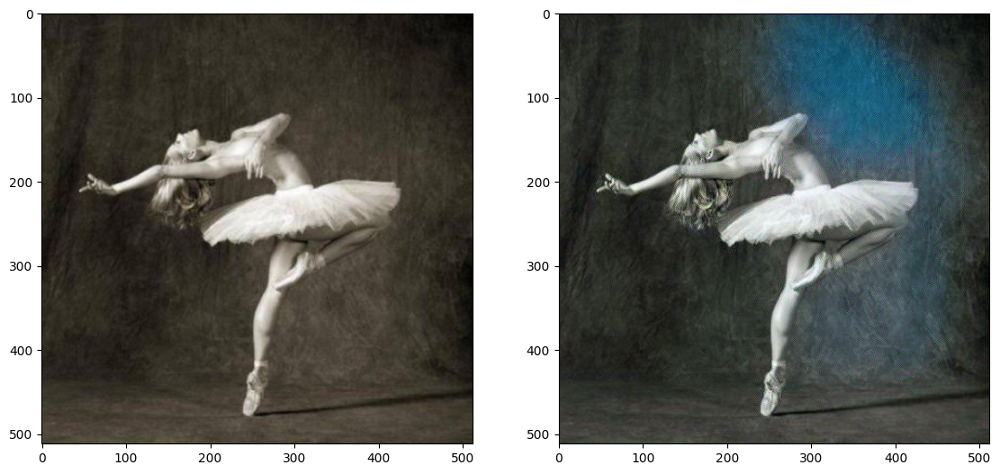

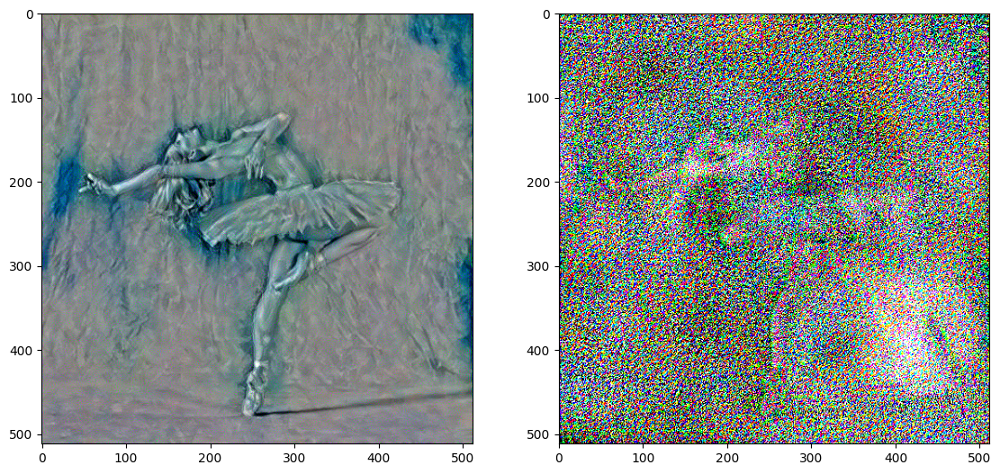

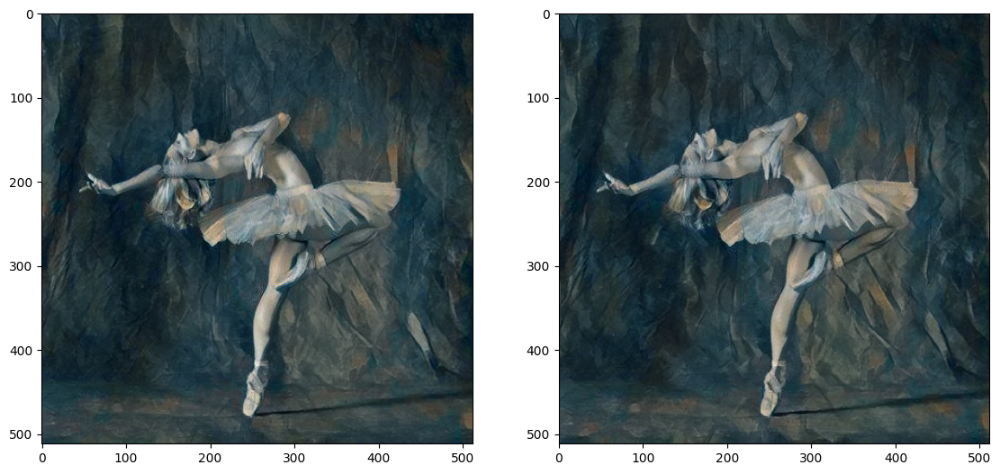

In [16]:
plot_imgs([load_img(content_path), output_image1], size=7)
plot_imgs([output_image2, output_image3], size=7)
plot_imgs([output_image4, output_image5], size=7)

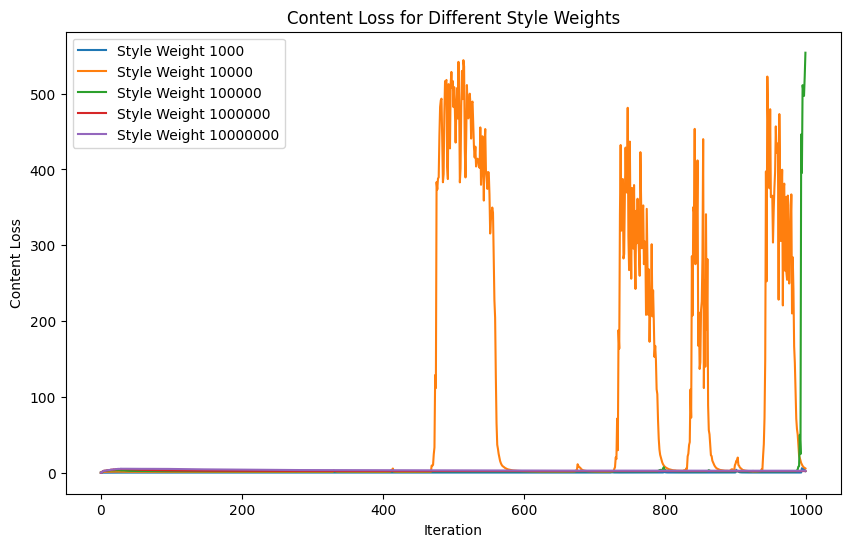

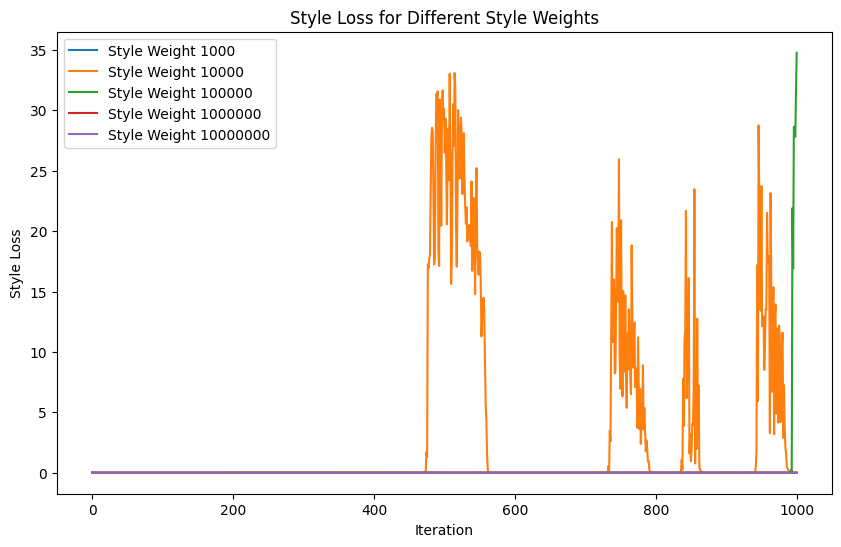

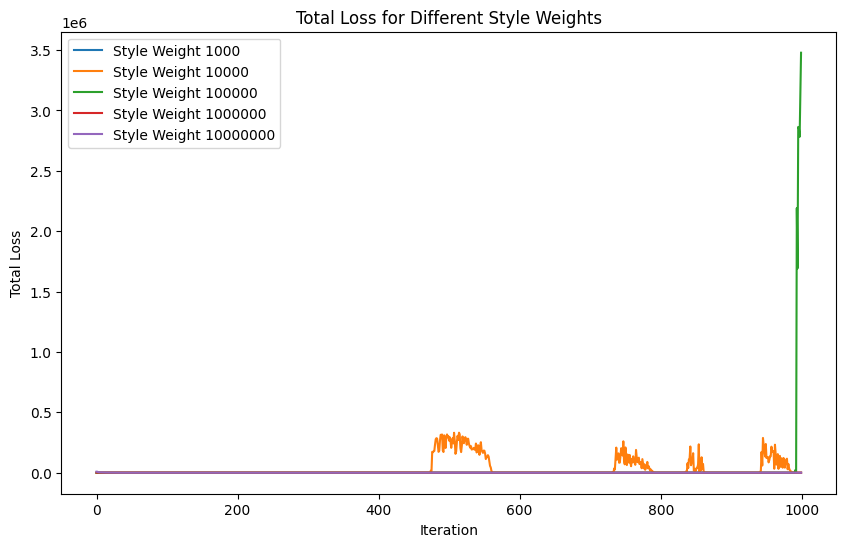

In [17]:
# Giả sử bạn có các giá trị loss từ mỗi lần chạy
content_loss_list = [content_loss1, content_loss2, content_loss3, content_loss4, content_loss5]
style_loss_list = [style_loss1, style_loss2, style_loss3, style_loss4, style_loss5]
total_loss_list = [total_loss1, total_loss2, total_loss3, total_loss4, total_loss5]

style_weights = [1000, 10000, 100000, 1000000, 10000000]  # Giá trị của style_weight

# Tạo biểu đồ cho content loss
plt.figure(figsize=(10, 6))
for i in range(len(content_loss_list)):
    plt.plot(content_loss_list[i][:1000], label=f'Style Weight {style_weights[i]}')

plt.xlabel('Iteration')
plt.ylabel('Content Loss')
plt.title('Content Loss for Different Style Weights')
plt.legend()
plt.show()

# Tạo biểu đồ cho style loss
plt.figure(figsize=(10, 6))
for i in range(len(style_loss_list)):
    plt.plot(style_loss_list[i][:1000], label=f'Style Weight {style_weights[i]}')

plt.xlabel('Iteration')
plt.ylabel('Style Loss')
plt.title('Style Loss for Different Style Weights')
plt.legend()
plt.show()

# Tạo biểu đồ cho total loss
plt.figure(figsize=(10, 6))
for i in range(len(total_loss_list)):
    plt.plot(total_loss_list[i][:1000], label=f'Style Weight {style_weights[i]}')

plt.xlabel('Iteration')
plt.ylabel('Total Loss')
plt.title('Total Loss for Different Style Weights')
plt.legend()
plt.show()

**Change Style Weight**

style_weight = 1000000, 
content_weight = [1,10,100,1000,10000], 
num_steps = 1000, 
content = dancing image, style = seated nude image

In [18]:
content_path = '/kaggle/input/content-img/content_dancing.jpg'
style_path = '/kaggle/input/style-img/style_seated-nude.jpg'

output_image1, content_loss1, style_loss1, total_loss1 = output_update(content_path, style_path, 1000, 1000000, 0.1)
output_image2, content_loss2, style_loss2, total_loss2 = output_update(content_path, style_path, 1000, 1000000, 1)
output_image3, content_loss3, style_loss3, total_loss3 = output_update(content_path, style_path, 1000, 1000000, 10)
output_image4, content_loss4, style_loss4, total_loss4 = output_update(content_path, style_path, 1000, 1000000, 100)
output_image5, content_loss5, style_loss5, total_loss5 = output_update(content_path, style_path, 1000, 1000000, 1000)

Optimizing...
content_loss:  5.158682823181152 style_loss:  4.280696430214448e-06
content_loss:  4.9543328285217285 style_loss:  9.514566272628144e-07
content_loss:  4.321279048919678 style_loss:  5.238600238044455e-07
content_loss:  3.9303946495056152 style_loss:  3.138992212825542e-07
content_loss:  3.640531539916992 style_loss:  2.0400716493895743e-07
content_loss:  3.422679901123047 style_loss:  1.33487020548273e-07
content_loss:  3.264370918273926 style_loss:  8.702635057034058e-08
content_loss:  3.136013984680176 style_loss:  6.012714948155917e-08
content_loss:  3.02705717086792 style_loss:  4.463351643835267e-08
content_loss:  2.9406676292419434 style_loss:  3.597981645953041e-08
content_loss:  2.874753952026367 style_loss:  3.0639718318070663e-08
content_loss:  2.8184170722961426 style_loss:  2.6918117512764184e-08
content_loss:  2.7759604454040527 style_loss:  2.4111567853424276e-08
content_loss:  2.742072582244873 style_loss:  2.2173106017930877e-08
content_loss:  2.714564561

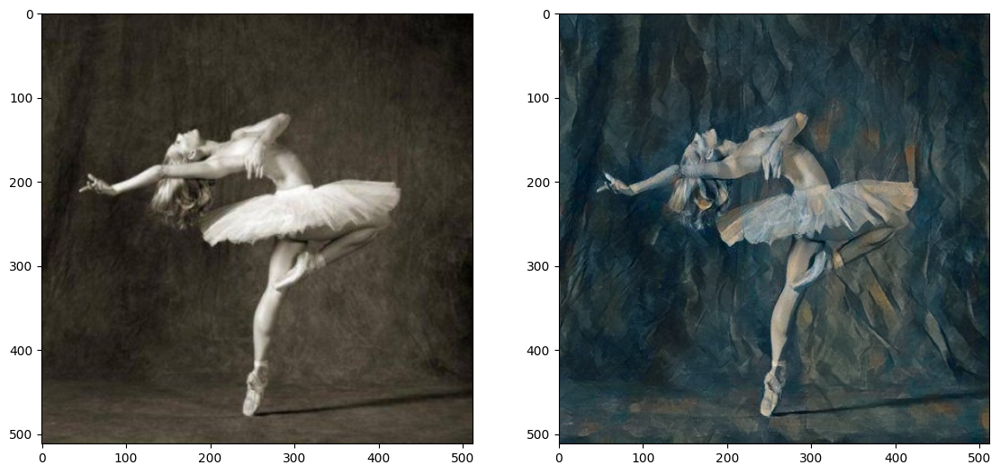

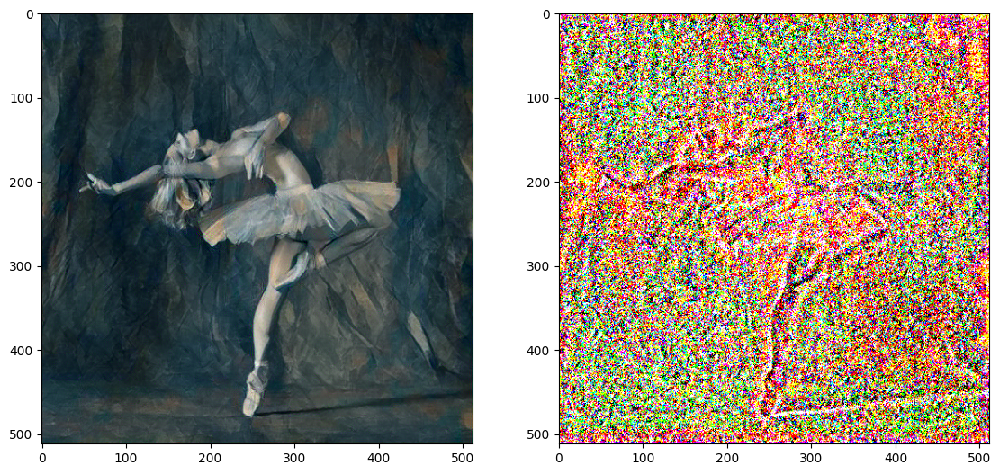

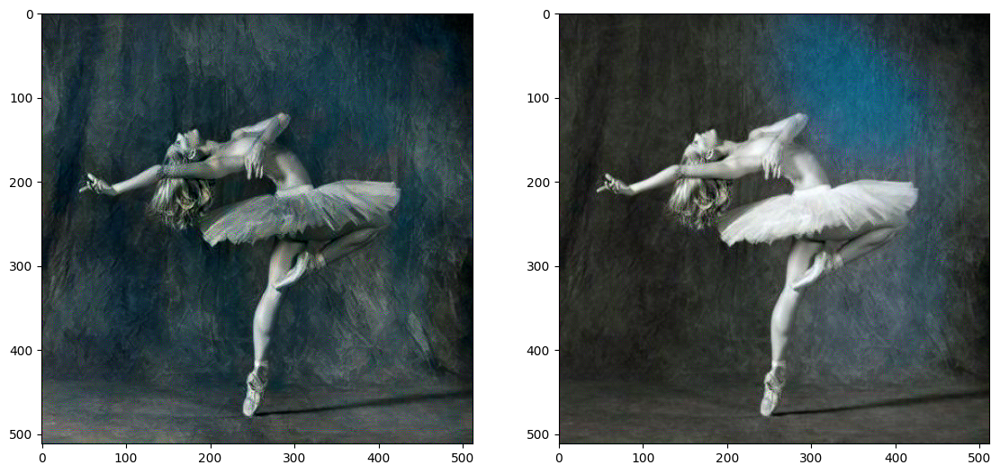

In [19]:
plot_imgs([load_img(content_path), output_image1], size=7)
plot_imgs([output_image2, output_image3], size=7)
plot_imgs([output_image4, output_image5], size=7)

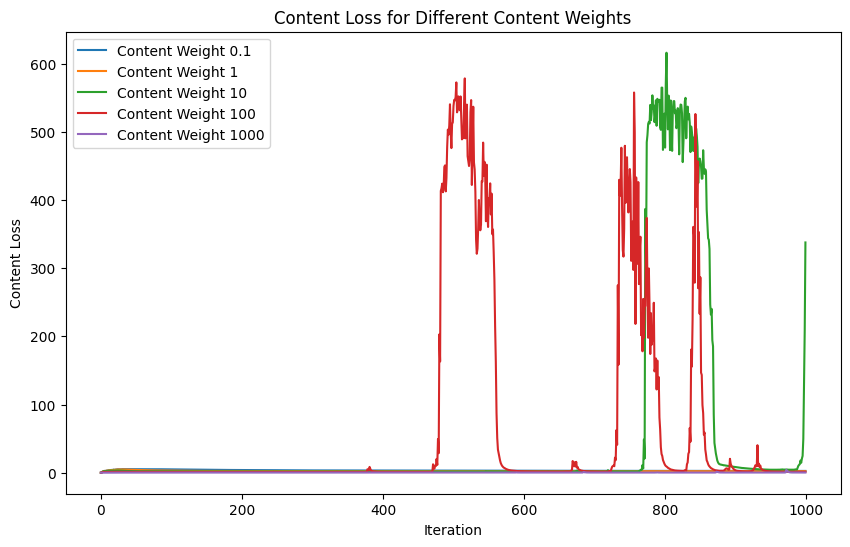

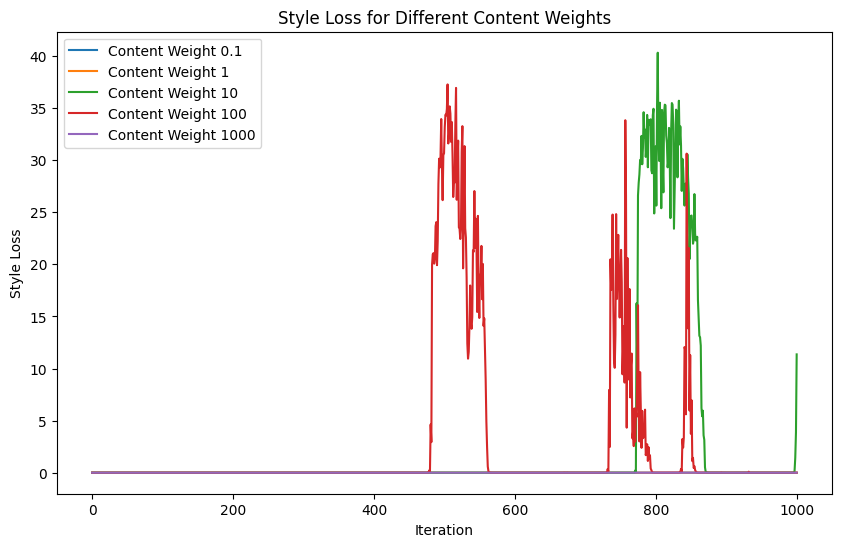

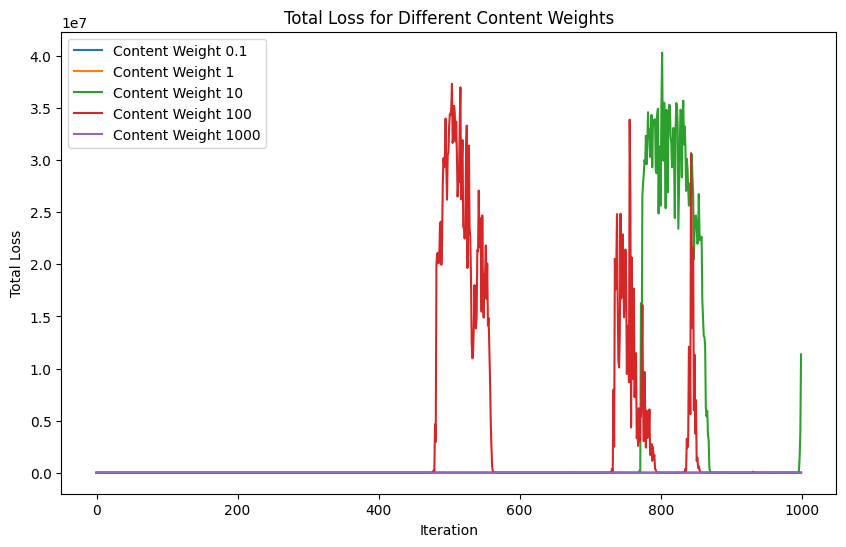

In [20]:
# Giả sử bạn có các giá trị loss từ mỗi lần chạy
content_loss_list = [content_loss1, content_loss2, content_loss3, content_loss4, content_loss5]
style_loss_list = [style_loss1, style_loss2, style_loss3, style_loss4, style_loss5]
total_loss_list = [total_loss1, total_loss2, total_loss3, total_loss4, total_loss5]

content_weights = [0.1, 1, 10, 100, 1000]  # Giá trị của style_weight

# Tạo biểu đồ cho content loss
plt.figure(figsize=(10, 6))
for i in range(len(content_loss_list)):
    plt.plot(content_loss_list[i][:1000], label=f'Content Weight {content_weights[i]}')

plt.xlabel('Iteration')
plt.ylabel('Content Loss')
plt.title('Content Loss for Different Content Weights')
plt.legend()
plt.show()

# Tạo biểu đồ cho style loss
plt.figure(figsize=(10, 6))
for i in range(len(style_loss_list)):
    plt.plot(style_loss_list[i][:1000], label=f'Content Weight {content_weights[i]}')

plt.xlabel('Iteration')
plt.ylabel('Style Loss')
plt.title('Style Loss for Different Content Weights')
plt.legend()
plt.show()

# Tạo biểu đồ cho total loss
plt.figure(figsize=(10, 6))
for i in range(len(total_loss_list)):
    plt.plot(total_loss_list[i][:1000], label=f'Content Weight {content_weights[i]}')

plt.xlabel('Iteration')
plt.ylabel('Total Loss')
plt.title('Total Loss for Different Content Weights')
plt.legend()
plt.show()